# MSU CMC - semantically aware style transfer

* You only need to send your solution, without accompanying files, in uncompressed form
* Rename your solution in the format [name]\_[surname].ipynb, for example Ivan_Ivanov.ipynb

In this work, you will modify [the baseline optimization-based style transfer method](https://www.cv-foundation.org/openaccess/content_cvpr_2016/papers/Gatys_Image_Style_Transfer_CVPR_2016_paper.pdf), with the following [implementation](https://github.com/leongatys/PytorchNeuralStyleTransfer/blob/master/NeuralStyleTransfer.ipynb). It makes uniform stylization of the whole content image with the whole style image. However, real artists apply different style to semantically different objects, such as people, buildings, cars and the background. You need to make spatially aware style transfer using several approaches, so that each part of content is stylized with some part of style (style parts may intersect). If you have any questions, write in telegram to @VictorKitov, I will answer to common chat.

The content image is split into parts based on semantic segmentation, that works on demo content images (`Images/Contents`). The style image is split into parts using [superpixels](https://scikit-image.org/docs/dev/auto_examples/segmentation/plot_segmentations.html) - you need to try several approaches and finetune hyperparameters for each approach. Afterwards the matching procedure takes place. Similar parts of style are matched to similar parts of content (many to one mapping). You need to select proximity criterion yourself, that works better - this may be closeness in RGB color distributuion or closeness in distribution of activations at some intermediate layer of the VGG neural network (measures closeness in patterns rather than in colors only). Alternatively this may be closeness in color distribution after both images were converted to grayscale (since originally content and style may consist of very different colors). Сloseness may be estimated by comparing the vectors of means and standard deviations for content and style part by Euclidean or cosine distance. 

Semantically aware style transfer can generate stylizations where different parts of content vary in style too much so an *averaging hyperparameter* is required: if 0, different parts of content are stylized with different parts of style. The closer is this hyperparameter to 1, the more uniform stylization becomes (more mixing of styles from all available superpixels at the matching stage). If 1 exaclty, the method reduces to uniform baseline style transfer.

Reporting your solution

The solution consists of several approaches that you try. Each approach starts from H1 heading "Method 1", "Method2", etc. Each method starts from textual description in markdown of your approach (pseudocode with latex preferred for clarity), naming which segmentation and superpixel algorithm with which parameters you choose, how you estimate closeness between segments and superpixels.
Then comes the code with its output: for _every content image in `Images/Contents` and every style image from `Images/Styles` (16 pairs)_ you show content  and its segmentation mask (1st row), style image and its superpixel mask (2nd row, matched parts of content and style should have the same color) and baseline stylization and semantically aware stylization side-by-side (3rd row). Each row extends to full jupyter notebook width for better visualization.

You solution is judged accorind to the following criteria
* Does it coinside with solution of some other student? If yes, both students get 0 points for the solution.
* How many approaches you test (+2 points for every method, 6 points max. Methods may differ in superpixel algorithm, preprocessing (color or grayscale) or closeness metric. Using the same method with different hyperparameters does not count - you should adjust hyperparameters for each method and report results with beset hyperparameters only.)
* Visual quality of your solutions compared to baseline (how well you selected the hyperparameters) - 4 points.
* Implement *averaging hyperparameter* for some method (2 points). You make a heading "Averaging", provide a markdown description of the averaging approach, the code and visualize content, style (one pair is enough) and 4 stylizations for averaging parameter 0, 0.33, 0.66, 1.



In [2]:
!python --version
!pip show torch
!nvidia-smi

Python 3.7.15
Name: torch
Version: 1.12.1+cu113
Summary: Tensors and Dynamic neural networks in Python with strong GPU acceleration
Home-page: https://pytorch.org/
Author: PyTorch Team
Author-email: packages@pytorch.org
License: BSD-3
Location: /usr/local/lib/python3.7/dist-packages
Requires: typing-extensions
Required-by: torchvision, torchtext, torchaudio, fastai
Mon Oct 31 16:57:57 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 000000

# Download VGG

In [3]:
!wget https://github.com/qiuxiaqing/vgg/raw/master/vgg_conv.pth.tar.gz

--2022-10-31 16:57:57--  https://github.com/qiuxiaqing/vgg/raw/master/vgg_conv.pth.tar.gz
Resolving github.com (github.com)... 140.82.113.4
Connecting to github.com (github.com)|140.82.113.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/qiuxiaqing/vgg/master/vgg_conv.pth.tar.gz [following]
--2022-10-31 16:57:57--  https://raw.githubusercontent.com/qiuxiaqing/vgg/master/vgg_conv.pth.tar.gz
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.111.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 87074406 (83M) [application/octet-stream]
Saving to: ‘vgg_conv.pth.tar.gz’

vgg_conv.pth.tar.gz 100%[===================>]  83.04M   172MB/s    in 0.5s    

2022-10-31 16:57:59 (172 MB/s) - ‘vgg_conv.pth.tar.gz’ saved [87074406/87074406]



In [4]:
!tar -xvf vgg_conv.pth.tar.gz

vgg_conv.pth


In [5]:
!pip install gdown

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [6]:
!gdown https://drive.google.com/uc?id=1kpaywCKvZtF8Y2X1cS8lqCwulY-bX-Ee
!unzip "DL Hometask-semantically aware ST.zip"

Downloading...
From: https://drive.google.com/uc?id=1kpaywCKvZtF8Y2X1cS8lqCwulY-bX-Ee
To: /content/DL Hometask-semantically aware ST.zip
100% 32.6M/32.6M [00:00<00:00, 78.4MB/s]
Archive:  DL Hometask-semantically aware ST.zip
   creating: DL Hometask-semantically aware ST/
   creating: DL Hometask-semantically aware ST/Images/
   creating: DL Hometask-semantically aware ST/Images/Contents/
  inflating: DL Hometask-semantically aware ST/Images/Contents/1.jpg  
  inflating: DL Hometask-semantically aware ST/Images/Contents/2.jpg  
  inflating: DL Hometask-semantically aware ST/Images/Contents/3.jpg  
   creating: DL Hometask-semantically aware ST/Images/Styles/
  inflating: DL Hometask-semantically aware ST/Images/Styles/1.jpg  
  inflating: DL Hometask-semantically aware ST/Images/Styles/2.jpg  
  inflating: DL Hometask-semantically aware ST/Images/Styles/3.jpg  
  inflating: DL Hometask-semantically aware ST/Semantically aware style transfer.ipynb  


In [85]:
import pandas as pd
import numpy as np

from PIL import Image
from scipy.stats import pearsonr, spearmanr
from skimage.segmentation import felzenszwalb, slic, quickshift, watershed
from skimage.segmentation import mark_boundaries

import matplotlib.pyplot as plt
import seaborn as sns

DEVICE = "cuda"

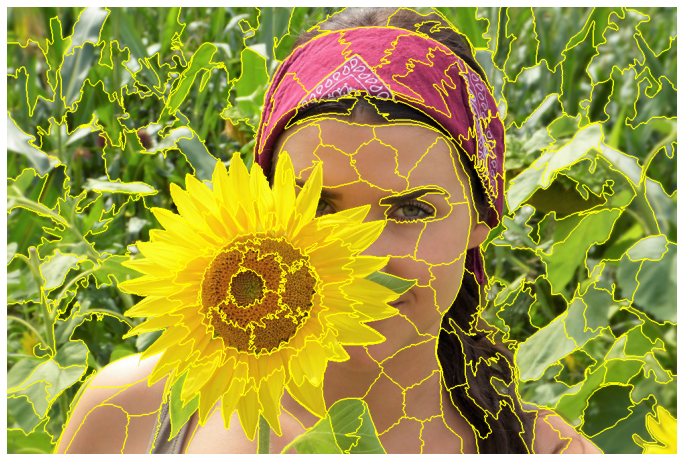

In [44]:
def show_image(img, figsize=(12,10)):
    fig, ax = plt.subplots(figsize=figsize)
    ax.imshow(img)
    ax.spines['top'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.set_xticks([])
    ax.set_yticks([])
    plt.show()

path = "/content/DL Hometask-semantically aware ST/Images/Contents/1.jpg"
img = Image.open(path)
w, h = img.size
img = img.resize((w//4, h//4))
segments_slic = slic(img, n_segments=250, compactness=10, sigma=1,
                     start_label=1)
show_image(mark_boundaries(img, segments_slic, mode="thick"), figsize=(12,10))

In [45]:
import time
import os

import torch
from torch.autograd import Variable
import torch.nn as nn
import torch.nn.functional as F
from torch import optim

import torchvision
from torchvision import transforms

from PIL import Image
from collections import OrderedDict

In [46]:
#vgg definition that conveniently let's you grab the outputs from any layer
class VGG(nn.Module):
    def __init__(self, pool='max'):
        super(VGG, self).__init__()
        #vgg modules
        self.conv1_1 = nn.Conv2d(3, 64, kernel_size=3, padding=1)
        self.conv1_2 = nn.Conv2d(64, 64, kernel_size=3, padding=1)
        self.conv2_1 = nn.Conv2d(64, 128, kernel_size=3, padding=1)
        self.conv2_2 = nn.Conv2d(128, 128, kernel_size=3, padding=1)
        self.conv3_1 = nn.Conv2d(128, 256, kernel_size=3, padding=1)
        self.conv3_2 = nn.Conv2d(256, 256, kernel_size=3, padding=1)
        self.conv3_3 = nn.Conv2d(256, 256, kernel_size=3, padding=1)
        self.conv3_4 = nn.Conv2d(256, 256, kernel_size=3, padding=1)
        self.conv4_1 = nn.Conv2d(256, 512, kernel_size=3, padding=1)
        self.conv4_2 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv4_3 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv4_4 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv5_1 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv5_2 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv5_3 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv5_4 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        if pool == 'max':
            self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2)
            self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2)
            self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2)
            self.pool4 = nn.MaxPool2d(kernel_size=2, stride=2)
            self.pool5 = nn.MaxPool2d(kernel_size=2, stride=2)
        elif pool == 'avg':
            self.pool1 = nn.AvgPool2d(kernel_size=2, stride=2)
            self.pool2 = nn.AvgPool2d(kernel_size=2, stride=2)
            self.pool3 = nn.AvgPool2d(kernel_size=2, stride=2)
            self.pool4 = nn.AvgPool2d(kernel_size=2, stride=2)
            self.pool5 = nn.AvgPool2d(kernel_size=2, stride=2)
            
    def forward(self, x, out_keys):
        out = {}
        out['r11'] = F.relu(self.conv1_1(x))
        out['r12'] = F.relu(self.conv1_2(out['r11']))
        out['p1'] = self.pool1(out['r12'])
        out['r21'] = F.relu(self.conv2_1(out['p1']))
        out['r22'] = F.relu(self.conv2_2(out['r21']))
        out['p2'] = self.pool2(out['r22'])
        out['r31'] = F.relu(self.conv3_1(out['p2']))
        out['r32'] = F.relu(self.conv3_2(out['r31']))
        out['r33'] = F.relu(self.conv3_3(out['r32']))
        out['r34'] = F.relu(self.conv3_4(out['r33']))
        out['p3'] = self.pool3(out['r34'])
        out['r41'] = F.relu(self.conv4_1(out['p3']))
        out['r42'] = F.relu(self.conv4_2(out['r41']))
        out['r43'] = F.relu(self.conv4_3(out['r42']))
        out['r44'] = F.relu(self.conv4_4(out['r43']))
        out['p4'] = self.pool4(out['r44'])
        out['r51'] = F.relu(self.conv5_1(out['p4']))
        out['r52'] = F.relu(self.conv5_2(out['r51']))
        out['r53'] = F.relu(self.conv5_3(out['r52']))
        out['r54'] = F.relu(self.conv5_4(out['r53']))
        out['p5'] = self.pool5(out['r54'])
        return [out[key] for key in out_keys]

# Original image processing

< ===

In [47]:
# pre and post processing for images
img_size = 512 
prep = transforms.Compose([transforms.Resize(img_size),
                           transforms.ToTensor(),
                           transforms.Lambda(lambda x: x[torch.LongTensor([2,1,0])]), #turn to BGR
                           transforms.Normalize(mean=[0.40760392, 0.45795686, 0.48501961], #subtract imagenet mean
                                                std=[1,1,1]),
                           transforms.Lambda(lambda x: x.mul_(255)),
                          ])
postpa = transforms.Compose([transforms.Lambda(lambda x: x.mul_(1./255)),
                           transforms.Normalize(mean=[-0.40760392, -0.45795686, -0.48501961], #add imagenet mean
                                                std=[1,1,1]),
                           transforms.Lambda(lambda x: x[torch.LongTensor([2,1,0])]), #turn to RGB
                           ])
postpb = transforms.Compose([transforms.ToPILImage()])
def postp(tensor): # to clip results in the range [0,1]
    t = postpa(tensor)
    t[t>1] = 1    
    t[t<0] = 0
    img = postpb(t)
    return img

=== >

In [48]:
# preprocessing for NN segmentation
prepseg = transforms.Compose([transforms.Resize(img_size),
                           transforms.ToTensor(),
                           transforms.Normalize(mean=[0.40760392, 0.45795686, 0.48501961], #subtract imagenet mean
                                                std=[0.225, 0.224, 0.229]),
                          ])

In [49]:
#get network
vgg = VGG()
vgg.load_state_dict(torch.load('vgg_conv.pth'))
for param in vgg.parameters():
    param.requires_grad = False
vgg.to(DEVICE)

VGG(
  (conv1_1): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv1_2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv2_1): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv2_2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv3_1): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv3_2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv3_3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv3_4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv4_1): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv4_2): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv4_3): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv4_4): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv5_1): Conv2d(512, 512,

In [104]:
#load images, ordered as [style_image, content_image]

def load_images(fname_s, fname_c):
    img_names = [
            "/content/DL Hometask-semantically aware ST/Images/Styles/" + fname_s,
            "/content/DL Hometask-semantically aware ST/Images/Contents/" + fname_c,
            #"/content/DL Hometask-semantically aware ST/Images/Contents/mask.jpg",
            ]
    imgs = [Image.open(name) for name in img_names]
    width, height = imgs[0].size
    width, height = 10**6 // height, 10**6 // width
    imgs[0] = imgs[0].resize((width, height))
    imgs_torch = [prep(img) for img in imgs]
    imgs_torch = [Variable(img.unsqueeze(0).to(DEVICE)) for img in imgs_torch]
    style_image, content_image = imgs_torch # b c h w, 0-255

    return imgs, style_image, content_image

imgs, style_image, content_image = load_images("1.jpg", "1.jpg")
# transform = transforms.Resize((800, 800))
# mask_image = transform(mask_image)
# content_image = transform(content_image)

User-defined mask

In [51]:
# x = postp(mask_image.cpu().squeeze())
# x = transforms.ToTensor()(x)[0].unsqueeze(0).unsqueeze(0)
# print(x.shape, x.max())
# mask_image = x.to(DEVICE)

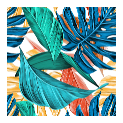

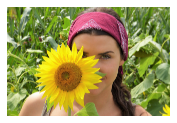

In [52]:
for img in imgs:
    show_image(img, figsize=(3, 2))

# Original method

< ===

In [53]:
# gram matrix and loss
class GramMatrix(nn.Module):
    def forward(self, input):
        b,c,h,w = input.size()
        F = input.view(b, c, h*w)
        G = torch.bmm(F, F.transpose(1,2)) 
        G.div_(h*w)
        return G

class GramMSELoss(nn.Module):
    def forward(self, input, target):
        out = nn.MSELoss()(GramMatrix()(input), target)
        return(out)

=== >

In [54]:
#define layers, loss functions, weights and compute optimization targets
style_layers = ['r11','r21','r31','r41', 'r51'] 
content_layers = ['r42']
loss_layers = style_layers + content_layers
loss_fns = [GramMSELoss()] * len(style_layers) + [nn.MSELoss()] * len(content_layers)
loss_fns = [loss_fn.to(DEVICE) for loss_fn in loss_fns]
    
#these are good weights settings:
style_weights = [1e3/n**2 for n in [64,128,256,512,512]]
content_weights = [1e0]
weights = style_weights + content_weights

#compute optimization targets
style_targets = [GramMatrix()(A).detach() for A in vgg(style_image, style_layers)]
content_targets = [A.detach() for A in vgg(content_image, content_layers)]
targets = style_targets + content_targets

In [55]:
def original_style_transfer(style_image, content_image, max_iter=500):
    # gram matrix and loss
    class GramMatrix(nn.Module):
        def forward(self, input):
            b,c,h,w = input.size()
            F = input.view(b, c, h*w)
            G = torch.bmm(F, F.transpose(1,2)) 
            G.div_(h*w)
            return G

    class GramMSELoss(nn.Module):
        def forward(self, input, target):
            out = nn.MSELoss()(GramMatrix()(input), target)
            return(out)

    #define layers, loss functions, weights and compute optimization targets
    style_layers = ['r11','r21','r31','r41', 'r51'] 
    content_layers = ['r42']
    loss_layers = style_layers + content_layers
    loss_fns = [GramMSELoss()] * len(style_layers) + [nn.MSELoss()] * len(content_layers)
    loss_fns = [loss_fn.to(DEVICE) for loss_fn in loss_fns]
        
    #these are good weights settings:
    style_weights = [1e3/n**2 for n in [64,128,256,512,512]]
    content_weights = [1e0]
    weights = style_weights + content_weights

    #compute optimization targets
    style_targets = [GramMatrix()(A).detach() for A in vgg(style_image, style_layers)]
    content_targets = [A.detach() for A in vgg(content_image, content_layers)]
    targets = style_targets + content_targets

    # opt_img = Variable(torch.randn(content_image.size()).type_as(content_image.data), requires_grad=True) #random init
    opt_img = Variable(content_image.data.clone(), requires_grad=True)

    show_iter = 50
    optimizer = optim.LBFGS([opt_img]);
    n_iter=[0]

    while n_iter[0] <= max_iter:

        def closure():
            optimizer.zero_grad()
            out = vgg(opt_img, loss_layers)  # VGG embedding of result image
            layer_losses = [weights[a] * loss_fns[a](A, targets[a]) for a,A in enumerate(out)]  # loss(out embedding, x_c embedding or x_s gram matrix)
            loss = sum(layer_losses)
            loss.backward()
            n_iter[0]+=1
            #print loss
            if n_iter[0]%show_iter == (show_iter-1):
                print('Iteration: %d, loss: %f'%(n_iter[0]+1, loss.item()))
    #             print([loss_layers[li] + ': ' +  str(l.data[0]) for li,l in enumerate(layer_losses)]) #loss of each layer
            return loss
        
        optimizer.step(closure)
        
    #display result
    out_img = postp(opt_img.data[0].cpu().squeeze())
    return out_img
    #show_image(out_img)
    #gcf().set_size_inches(10,10)

# Multiclass segmentation of content

In [73]:
def deeplab_segment(content_image):
    content_segm = prepseg(content_image)
    #print(content_segm.shape, content_segm.min(), content_segm.max())
    segmodel = torch.hub.load('pytorch/vision:v0.10.0', 'deeplabv3_resnet101', pretrained=True).eval().to(DEVICE)
    with torch.no_grad():
        output = segmodel(content_segm.unsqueeze(0).to(DEVICE))['out'][0]
    content_seg = output.argmax(0).unsqueeze(0).unsqueeze(0) + 1  # dtype int 0-19 shape 1 1 h w

    return content_seg

content_seg = deeplab_segment(imgs[1])

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=DeepLabV3_ResNet101_Weights.COCO_WITH_VOC_LABELS_V1`. You can also use `weights=DeepLabV3_ResNet101_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [74]:
print(content_seg.shape)
print(content_image.shape)

torch.Size([1, 1, 539, 512])
torch.Size([1, 3, 539, 512])


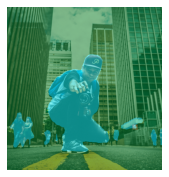

In [75]:
def segmap_p(mask):
    # create a color pallette, selecting a color for each class
    palette = torch.tensor([2 ** 25 - 1, 2 ** 15 - 1, 2 ** 21 - 1])
    colors = torch.as_tensor([i for i in range(22)])[:, None] * palette
    colors = (colors % 255).numpy().astype("uint8")

    # plot the semantic segmentation predictions of 21 classes in each color
    r = Image.fromarray(mask[0, 0].byte().cpu().numpy())
    r.putpalette(colors)
    return r

r = segmap_p(content_seg)
r = Image.blend(r.convert("RGB"), postp(content_image.cpu().squeeze()), 0.5)

show_image(r, figsize=(6,3))

# Superpixel segmentation of style

In [59]:
def superpixel_segment(style_image, params={"n_segments":50, "compactness":10, "sigma":0.5}):
    segments_slic = slic(style_image, start_label=1, **params)
    prep_superpix = transforms.Compose([
                           transforms.ToTensor(),
                           transforms.Resize(img_size)
                          ])
    style_seg = prep_superpix(segments_slic).unsqueeze(0).to(DEVICE)
    # print(style_seg.shape, style_seg.dtype)
    # print(style_image.shape)

    return style_seg

style_seg = superpixel_segment(imgs[0])

Style size: (5000, 5000)
Superpixel mask shape: torch.Size([1, 1, 512, 512]) segment numbers: tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10], device='cuda:0')


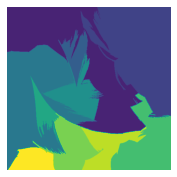

In [60]:
print("Style size:", imgs[0].size)
print("Superpixel mask shape:", style_seg.shape, "segment numbers:", style_seg.unique())
show_image(style_seg[0, 0].cpu().numpy(), figsize=(6,3))

# Spatially aware style transfer

< ===

In [61]:
from torchvision.transforms import InterpolationMode

eps = 1e-6

def segment_closeness(sega, segb, Fa, Fb, vgg_i):
    # sega: semantic segmentation
    # segb: superpixel segmentation
    # For each segment in maska output a weight matrix for maskb
    b, c, h, w = Fa.shape
    transform = transforms.Resize((h, w), InterpolationMode.NEAREST)
    sega = transform(sega).expand(Fa.shape)

    b, c, h, w = Fb.shape
    transform = transforms.Resize((h, w), InterpolationMode.NEAREST)
    segb = transform(segb).expand(Fb.shape)
    
    out_masks = []
    b_segments = segb.unique()
    #print("Sega unique", sega.unique())
    visualmask = torch.zeros_like(segb, dtype=torch.float).to(DEVICE) + 22
    for i in sega.unique():
        weightmask = torch.zeros_like(segb, dtype=torch.float).to(DEVICE)
        if (sega == i).sum() > 1:
            feat_a = Fa * (sega == i)
            for j in b_segments:
                maskb = (segb == j)
                if maskb.sum() > 1:
                    feat_b = Fb * (maskb)
                    # compare means of segments
                    meana = feat_a.mean(dim=2).mean(dim=2)
                    meanb = feat_b.mean(dim=2).mean(dim=2)
                    diff = ((meana - meanb) ** 2).mean()
                else:
                    diff = 1/eps
                weightmask[maskb] = 1/(diff+eps) # save diff in mask
            b, c, h, w = Fb.shape
            maximum = weightmask.max()
            mask = (weightmask >= maximum - eps)
            weightmask[mask] = 1
            weightmask[~mask] = 0
            visualmask[mask] = float(i)
        out_masks.append(weightmask[:, 0].detach())
    return out_masks, visualmask.detach()  # [ tensor(b, c, h, w), ... ]


# gram matrix and loss
class GramMatrix(nn.Module):
    def __init__(self, mask):
        super().__init__()
        self.mask = mask

    def forward(self, input):
        b,c,h,w = input.size()
        F = input.view(b, c, h*w)
        transform = transforms.Resize((h, w))
        mask_resized = transform(self.mask).view(b, 1, h*w)
        G = torch.bmm(F*mask_resized, F.transpose(1,2))
        G.div_(mask_resized.sum())
        return G

class GramMSELoss(nn.Module):
    def __init__(self, content_mask, style_mask, fc, fs, vgg_i):
        super().__init__()
        self.content_mask = content_mask
        self.style_mask = style_mask
        self.weightmask, self.visualmask = segment_closeness(self.content_mask, self.style_mask, fc, fs, vgg_i)
        #show_image(self.weightmask[0][0].cpu().numpy())

    def forward(self, input, target):
        # input: vgg embedding of out
        # target: gram matrix of x_s
        #print("content mask", self.content_mask.shape, "style mask", self.style_mask.shape, "Fa", input.shape, "Fb", target.shape)
        loss_sum = []
        for i, objcls in enumerate(self.content_mask.unique()):
            mask = (self.content_mask == objcls)  # shape h w
            if mask.sum() < 1:  # very small segmented areas
                continue
            style_m = self.weightmask[i]
            loss_sum.append( nn.MSELoss()(GramMatrix(mask)(input), GramMatrix(style_m)(target)) )
        return torch.stack(loss_sum).sum()

In [62]:
# def create_mask_image(img):
#     b, c, h, w = img.shape
#     mask = torch.zeros(b, 1, h, w)
#     mask[:, :, :, :w//2] = 1
#     return mask

# mask_image = create_mask_image(content_image).to(DEVICE)

=== >

In [63]:
#run style transfer

def style_transfer(style_image, content_image, content_seg, style_seg, s_alpha=1, max_iter=100):
    #define layers, loss functions, weights and compute optimization targets
    style_layers = ['r11','r21','r31','r41', 'r51'] 
    content_layers = ['r42']
    loss_layers = style_layers + content_layers

    #these are good weights settings:
    style_weights = [s_alpha*1e3/n**2 for n in [64,128,256,512,512]]
    content_weights = [1e0]
    weights = style_weights + content_weights

    #compute optimization targets
    style_targets = [A.detach() for A in vgg(style_image, style_layers)]
    content_targets = [A.detach() for A in vgg(content_image, content_layers)]
    targets = style_targets + content_targets

    #loss functions
    loss_fns = (
        [GramMSELoss(content_seg, style_seg, C, S, i) for C, S, i in zip( vgg(content_image, style_layers), style_targets, list(range(len(style_targets))) )] 
        + [nn.MSELoss()] * len(content_layers)
    )
    loss_fns = [loss_fn.to(DEVICE) for loss_fn in loss_fns]
    
    superpixel_visual = loss_fns[0].visualmask

    # opt_img = Variable(torch.randn(content_image.size()).type_as(content_image.data), requires_grad=True) #random init
    opt_img = Variable(content_image.data.clone(), requires_grad=True)

    #max_iter = 100
    show_iter = 50
    optimizer = optim.LBFGS([opt_img]);
    n_iter=[0]

    while n_iter[0] <= max_iter:

        def closure():
            optimizer.zero_grad()
            out = vgg(opt_img, loss_layers)  # VGG embedding of result image
            layer_losses = [weights[a] * loss_fns[a](A, targets[a]) for a,A in enumerate(out)]  # loss(out embedding, x_c embedding or x_s gram matrix)
            loss = sum(layer_losses)
            loss.backward()
            n_iter[0]+=1
            #print loss
            if n_iter[0]%show_iter == (show_iter-1):
                print('Iteration: %d, loss: %f'%(n_iter[0]+1, loss.item()))
    #             print([loss_layers[li] + ': ' +  str(l.data[0]) for li,l in enumerate(layer_losses)]) #loss of each layer
            return loss
        
        optimizer.step(closure)
        
    #display result
    out_img = postp(opt_img.data[0].cpu().squeeze())
    return out_img, superpixel_visual
    #show_image(out_img)
    #gcf().set_size_inches(10,10)

# Method 1
Segment the content image using DeepLabv3, obtain a HxW mask, each pixel contains integer in range [0, 20] — the class of pixel. Segment the style image using superpixel segmentation, obtain a mask similar to the content segmentation, but with arbitrary number of classes. Extract a list of layers for content and style images from VGG, on which style loss is defined. On each layer, compute the difference between each content segment and style segment. Layers have different spatial resolution, thus the segmentation masks are resized to the resoltion of layers. For each content segment, select the closest style segment in the VGG feature space, and construct a binary mask to multiply by in the standard Gram matrix step:

$$ G^{lr}_{ij} = \frac{1}{\sum m}\sum_{u,v}m^r_{uv} F^l_{iuv}F^l_{juv} $$
where $G_{ij}$ is correlation between channels $i$, $j$ of a feature layer, $l$ is number of layer, $r$ is number of content or style segment, $u,v$ are spatial coordinates, $m$ is binary mask corresponding to segment, $F$ is VGG features. The mask for content Gram matrix is content segment, the mask for style Gram matrix is the closest style segment. The closeness is computed and applied independently on chosen VGG layers. Superpixel algorithm parameters are chosen, so that superpixels are large enough to provide style for a content segment. Closeness metric is MSE between feature averages in multiple VGG layers.

* Superpixel segmentation: SLIC

In [64]:
# Tile pictures
def draw_pictures(pictures, cols=5, figsize=(3, 3)):
    rows = (len(pictures)+cols-1) // cols
    figsize = (figsize[0] * cols, figsize[1] * rows)
    plt.figure(figsize=figsize) # (w, h)
    for i in range(len(pictures)):
        plt.subplot(rows,cols, i + 1)
        plt.axis('off')
        plt.imshow(pictures[i])
    plt.tight_layout()
    plt.show()

In [79]:
imgs, style_image, content_image = load_images("2.jpg", "1.jpg")
content_seg = deeplab_segment(imgs[1])
style_seg = superpixel_segment(imgs[0], params={"n_segments":50, "compactness":10, "sigma":0.5})

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


In [80]:
out, superpixel_visual = style_transfer(style_image, content_image, content_seg, style_seg, max_iter=100)

Iteration: 50, loss: 96233928.000000
Iteration: 100, loss: 41270520.000000


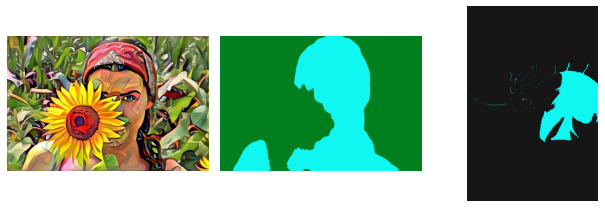

In [82]:
pictures = [out, segmap_p(content_seg), segmap_p(superpixel_visual.cpu())]
draw_pictures(pictures, cols=3)

In [83]:
pictures = []
for content in ["1.jpg", "2.jpg", "3.jpg"]:
    content_row = []
    for style in ["1.jpg", "2.jpg", "3.jpg"]:
        imgs, style_image, content_image = load_images(style, content)
        content_seg = deeplab_segment(imgs[1])
        style_seg = superpixel_segment(imgs[0], params={"n_segments":50, "compactness":10, "sigma":0.5})
        out, superpixel_visual = style_transfer(style_image, content_image, content_seg, style_seg, max_iter=500)
        original_out = original_style_transfer(style_image, content_image, max_iter=500)
        pictures += [imgs[1], segmap_p(content_seg.cpu()), imgs[0], segmap_p(superpixel_visual.cpu()), original_out, out]

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Iteration: 50, loss: 252596912.000000
Iteration: 100, loss: 124393592.000000
Iteration: 150, loss: 82760256.000000
Iteration: 200, loss: 62811004.000000
Iteration: 250, loss: 49426564.000000
Iteration: 300, loss: 42235976.000000
Iteration: 350, loss: 37539244.000000
Iteration: 400, loss: 34215684.000000
Iteration: 450, loss: 31817628.000000
Iteration: 500, loss: 30021588.000000
Iteration: 50, loss: 47562984.000000
Iteration: 100, loss: 18487124.000000
Iteration: 150, loss: 10230464.000000
Iteration: 200, loss: 5055882.000000
Iteration: 250, loss: 3679973.750000
Iteration: 300, loss: 3065406.000000
Iteration: 350, loss: 2520759.250000
Iteration: 400, loss: 2247651.000000
Iteration: 450, loss: 2070837.250000
Iteration: 500, loss: 1926306.125000


Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Iteration: 50, loss: 97741344.000000
Iteration: 100, loss: 41317808.000000
Iteration: 150, loss: 26424498.000000
Iteration: 200, loss: 19680958.000000
Iteration: 250, loss: 15855671.000000
Iteration: 300, loss: 13440040.000000
Iteration: 350, loss: 11755550.000000
Iteration: 400, loss: 10524758.000000
Iteration: 450, loss: 9650101.000000
Iteration: 500, loss: 8962566.000000
Iteration: 50, loss: 21667514.000000
Iteration: 100, loss: 7766992.000000
Iteration: 150, loss: 4453728.500000
Iteration: 200, loss: 3116037.000000
Iteration: 250, loss: 2399150.500000
Iteration: 300, loss: 1986993.000000
Iteration: 350, loss: 1727661.500000
Iteration: 400, loss: 1548307.000000
Iteration: 450, loss: 1420477.500000
Iteration: 500, loss: 1324728.000000


Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Iteration: 50, loss: 41380276.000000
Iteration: 100, loss: 13934885.000000
Iteration: 150, loss: 8846418.000000
Iteration: 200, loss: 7015171.000000
Iteration: 250, loss: 6045400.500000
Iteration: 300, loss: 5463489.500000
Iteration: 350, loss: 5056843.500000
Iteration: 400, loss: 4761992.000000
Iteration: 450, loss: 4556885.500000
Iteration: 500, loss: 4392034.500000
Iteration: 50, loss: 8601828.000000
Iteration: 100, loss: 2218916.000000
Iteration: 150, loss: 1300227.000000
Iteration: 200, loss: 1009604.375000
Iteration: 250, loss: 871190.750000
Iteration: 300, loss: 796236.375000
Iteration: 350, loss: 749524.375000
Iteration: 400, loss: 717271.500000
Iteration: 450, loss: 693463.000000
Iteration: 500, loss: 676161.687500


Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Iteration: 50, loss: 17623216128.000000
Iteration: 100, loss: 13799149568.000000
Iteration: 150, loss: 12447369216.000000
Iteration: 200, loss: 11764046848.000000
Iteration: 250, loss: 11385524224.000000
Iteration: 300, loss: 11149670400.000000
Iteration: 350, loss: 10967430144.000000
Iteration: 400, loss: 10827312128.000000
Iteration: 450, loss: 10728023040.000000
Iteration: 500, loss: 10652851200.000000
Iteration: 50, loss: 57985072.000000
Iteration: 100, loss: 16676086.000000
Iteration: 150, loss: 7585911.000000
Iteration: 200, loss: 4898174.000000
Iteration: 250, loss: 3912453.500000
Iteration: 300, loss: 3081651.500000
Iteration: 350, loss: 2647475.500000
Iteration: 400, loss: 2307441.500000
Iteration: 450, loss: 2062982.000000
Iteration: 500, loss: 1901257.875000


Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Iteration: 50, loss: 1253402752.000000
Iteration: 100, loss: 659596992.000000
Iteration: 150, loss: 472266112.000000
Iteration: 200, loss: 376463808.000000
Iteration: 250, loss: 317930976.000000
Iteration: 300, loss: 276915040.000000
Iteration: 350, loss: 247213328.000000
Iteration: 400, loss: 223477280.000000
Iteration: 450, loss: 204300160.000000
Iteration: 500, loss: 188383088.000000
Iteration: 50, loss: 26873042.000000
Iteration: 100, loss: 10369090.000000
Iteration: 150, loss: 5742558.500000
Iteration: 200, loss: 3875853.500000
Iteration: 250, loss: 2897659.750000
Iteration: 300, loss: 2334871.750000
Iteration: 350, loss: 1976785.250000
Iteration: 400, loss: 1722352.750000
Iteration: 450, loss: 1555156.250000
Iteration: 500, loss: 1428371.500000


Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Iteration: 50, loss: 21460842496.000000
Iteration: 100, loss: 9523287040.000000
Iteration: 150, loss: 7030827008.000000
Iteration: 200, loss: 5998957056.000000
Iteration: 250, loss: 5429708800.000000
Iteration: 300, loss: 5130465792.000000
Iteration: 350, loss: 4943573504.000000
Iteration: 400, loss: 4808592896.000000
Iteration: 450, loss: 4714958848.000000
Iteration: 500, loss: 4649792512.000000
Iteration: 50, loss: 7592544.500000
Iteration: 100, loss: 2557434.250000
Iteration: 150, loss: 1523340.875000
Iteration: 200, loss: 1145777.750000
Iteration: 250, loss: 954500.250000
Iteration: 300, loss: 846764.875000
Iteration: 350, loss: 777344.437500
Iteration: 400, loss: 732038.000000
Iteration: 450, loss: 699862.937500
Iteration: 500, loss: 676495.937500


Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Iteration: 50, loss: 407813056.000000
Iteration: 100, loss: 173225280.000000
Iteration: 150, loss: 113327824.000000
Iteration: 200, loss: 86848584.000000
Iteration: 250, loss: 72172264.000000
Iteration: 300, loss: 61963016.000000
Iteration: 350, loss: 54348304.000000
Iteration: 400, loss: 48754976.000000
Iteration: 450, loss: 44586560.000000
Iteration: 500, loss: 41623060.000000
Iteration: 50, loss: 41193220.000000
Iteration: 100, loss: 11915297.000000
Iteration: 150, loss: 6474904.500000
Iteration: 200, loss: 4646618.000000
Iteration: 250, loss: 3601457.250000
Iteration: 300, loss: 3050184.000000
Iteration: 350, loss: 2681405.500000
Iteration: 400, loss: 2388930.250000
Iteration: 450, loss: 2193438.500000
Iteration: 500, loss: 2046005.750000


Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Iteration: 50, loss: 159092896.000000
Iteration: 100, loss: 75178552.000000
Iteration: 150, loss: 47830848.000000
Iteration: 200, loss: 34568980.000000
Iteration: 250, loss: 27261758.000000
Iteration: 300, loss: 22202530.000000
Iteration: 350, loss: 18786242.000000
Iteration: 400, loss: 16344500.000000
Iteration: 450, loss: 14544818.000000
Iteration: 500, loss: 13103088.000000
Iteration: 50, loss: 29954050.000000
Iteration: 100, loss: 11847308.000000
Iteration: 150, loss: 6729375.500000
Iteration: 200, loss: 4614721.000000
Iteration: 250, loss: 3520601.250000
Iteration: 300, loss: 2887515.500000
Iteration: 350, loss: 2494311.250000
Iteration: 400, loss: 2234569.000000
Iteration: 450, loss: 2041422.500000
Iteration: 500, loss: 1894304.250000


Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Iteration: 50, loss: 39895660.000000
Iteration: 100, loss: 19525210.000000
Iteration: 150, loss: 13305119.000000
Iteration: 200, loss: 10463897.000000
Iteration: 250, loss: 8828130.000000
Iteration: 300, loss: 7771226.500000
Iteration: 350, loss: 7030451.500000
Iteration: 400, loss: 6511134.500000
Iteration: 450, loss: 6107775.000000
Iteration: 500, loss: 5803186.500000
Iteration: 50, loss: 7035467.500000
Iteration: 100, loss: 2679540.750000
Iteration: 150, loss: 1759350.500000
Iteration: 200, loss: 1388242.000000
Iteration: 250, loss: 1196116.750000
Iteration: 300, loss: 1077679.500000
Iteration: 350, loss: 999372.250000
Iteration: 400, loss: 943614.375000
Iteration: 450, loss: 903683.500000
Iteration: 500, loss: 874494.437500


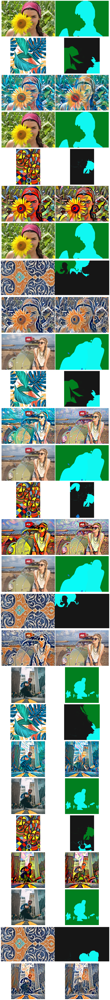

In [84]:
draw_pictures(pictures, cols=2, figsize=(6, 4))

# Method 2
* Superpixel segmentation: Felsenszwalb's efficient graph based image segmentation

In [113]:
def superpixel_segment_fz(style_image, params={"scale":100, "sigma":0.5, "min_size":5000}):
    segments_slic = felzenszwalb(style_image, **params)
    prep_superpix = transforms.Compose([
                           transforms.ToTensor(),
                           transforms.Resize(img_size)
                          ])
    style_seg = prep_superpix(segments_slic).unsqueeze(0).to(DEVICE)
    # print(style_seg.shape, style_seg.dtype)
    # print(style_image.shape)

    return style_seg

In [114]:
imgs, style_image, content_image = load_images("1.jpg", "1.jpg")
content_seg = deeplab_segment(imgs[1])
style_seg = superpixel_segment_fz(imgs[0])

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


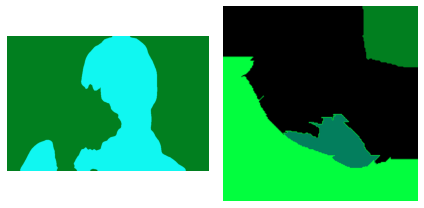

In [116]:
pictures = [segmap_p(content_seg), segmap_p(style_seg)]
draw_pictures(pictures, cols=3)

In [117]:
out, superpixel_visual = style_transfer(style_image, content_image, content_seg, style_seg, max_iter=100)

Iteration: 50, loss: 142154416.000000
Iteration: 100, loss: 66181680.000000


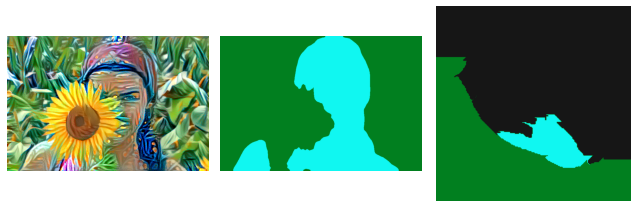

In [118]:
pictures = [out, segmap_p(content_seg), segmap_p(superpixel_visual.cpu())]
draw_pictures(pictures, cols=3)

In [121]:
pictures = []
for content in ["1.jpg", "2.jpg", "3.jpg"]:
    content_row = []
    for style in ["1.jpg", "2.jpg", "3.jpg"]:
        imgs, style_image, content_image = load_images(style, content)
        content_seg = deeplab_segment(imgs[1])
        style_seg = superpixel_segment_fz(imgs[0], params={"scale":100, "sigma":0.5, "min_size":5000})
        out, superpixel_visual = style_transfer(style_image, content_image, content_seg, style_seg, max_iter=500)
        original_out = original_style_transfer(style_image, content_image, max_iter=500)
        pictures += [imgs[1], segmap_p(content_seg.cpu()), imgs[0], segmap_p(superpixel_visual.cpu()), original_out, out]

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Iteration: 50, loss: 147274352.000000
Iteration: 100, loss: 73020432.000000
Iteration: 150, loss: 46809068.000000
Iteration: 200, loss: 35340032.000000
Iteration: 250, loss: 29381488.000000
Iteration: 300, loss: 24014692.000000
Iteration: 350, loss: 21278708.000000
Iteration: 400, loss: 19520166.000000
Iteration: 450, loss: 18241220.000000
Iteration: 500, loss: 17289640.000000
Iteration: 50, loss: 24812520.000000
Iteration: 100, loss: 11585999.000000
Iteration: 150, loss: 4868248.500000
Iteration: 200, loss: 2502014.000000
Iteration: 250, loss: 1876625.125000
Iteration: 300, loss: 1559001.500000
Iteration: 350, loss: 1366257.750000
Iteration: 400, loss: 1230678.000000
Iteration: 450, loss: 1143498.000000
Iteration: 500, loss: 1081644.500000


Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Iteration: 50, loss: 183435440.000000
Iteration: 100, loss: 130078608.000000
Iteration: 150, loss: 111113024.000000
Iteration: 200, loss: 102322216.000000
Iteration: 250, loss: 97170552.000000
Iteration: 300, loss: 93923496.000000
Iteration: 350, loss: 91725624.000000
Iteration: 400, loss: 90117152.000000
Iteration: 450, loss: 88879584.000000
Iteration: 500, loss: 87944504.000000
Iteration: 50, loss: 19428846.000000
Iteration: 100, loss: 7762248.000000
Iteration: 150, loss: 4361757.500000
Iteration: 200, loss: 3022807.500000
Iteration: 250, loss: 2310020.500000
Iteration: 300, loss: 1915294.500000
Iteration: 350, loss: 1659610.375000
Iteration: 400, loss: 1495232.875000
Iteration: 450, loss: 1368907.250000
Iteration: 500, loss: 1277577.000000


Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Iteration: 50, loss: 165302384.000000
Iteration: 100, loss: 94981032.000000
Iteration: 150, loss: 75956976.000000
Iteration: 200, loss: 67253824.000000
Iteration: 250, loss: 62237776.000000
Iteration: 300, loss: 59115648.000000
Iteration: 350, loss: 57026024.000000
Iteration: 400, loss: 55613064.000000
Iteration: 450, loss: 54582592.000000
Iteration: 500, loss: 53811904.000000
Iteration: 50, loss: 7065124.000000
Iteration: 100, loss: 1949200.625000
Iteration: 150, loss: 1146965.750000
Iteration: 200, loss: 893354.000000
Iteration: 250, loss: 780726.500000
Iteration: 300, loss: 715504.125000
Iteration: 350, loss: 674422.312500
Iteration: 400, loss: 645764.937500
Iteration: 450, loss: 624876.375000
Iteration: 500, loss: 608869.687500


Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Iteration: 50, loss: 1500772224.000000
Iteration: 100, loss: 841124160.000000
Iteration: 150, loss: 609345152.000000
Iteration: 200, loss: 487742752.000000
Iteration: 250, loss: 417303968.000000
Iteration: 300, loss: 369098336.000000
Iteration: 350, loss: 331425568.000000
Iteration: 400, loss: 302374656.000000
Iteration: 450, loss: 278997664.000000
Iteration: 500, loss: 260849664.000000
Iteration: 50, loss: 27149126.000000
Iteration: 100, loss: 9742554.000000
Iteration: 150, loss: 4325875.000000
Iteration: 200, loss: 2746044.500000
Iteration: 250, loss: 2160121.000000
Iteration: 300, loss: 1712463.500000
Iteration: 350, loss: 1459921.500000
Iteration: 400, loss: 1302308.250000
Iteration: 450, loss: 1174947.000000
Iteration: 500, loss: 1094355.250000


Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Iteration: 50, loss: 2440139008.000000
Iteration: 100, loss: 1550116224.000000
Iteration: 150, loss: 1233688704.000000
Iteration: 200, loss: 1074765056.000000
Iteration: 250, loss: 973878208.000000
Iteration: 300, loss: 907528320.000000
Iteration: 350, loss: 858363456.000000
Iteration: 400, loss: 820462784.000000
Iteration: 450, loss: 790624128.000000
Iteration: 500, loss: 766067520.000000
Iteration: 50, loss: 27648136.000000
Iteration: 100, loss: 10272895.000000
Iteration: 150, loss: 5565093.000000
Iteration: 200, loss: 3744841.000000
Iteration: 250, loss: 2784746.000000
Iteration: 300, loss: 2236315.000000
Iteration: 350, loss: 1897436.375000
Iteration: 400, loss: 1653120.000000
Iteration: 450, loss: 1482332.750000
Iteration: 500, loss: 1360581.125000


Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Iteration: 50, loss: 1294974976.000000
Iteration: 100, loss: 678846144.000000
Iteration: 150, loss: 497141280.000000
Iteration: 200, loss: 406944896.000000
Iteration: 250, loss: 355933536.000000
Iteration: 300, loss: 319200448.000000
Iteration: 350, loss: 292238752.000000
Iteration: 400, loss: 272757376.000000
Iteration: 450, loss: 257001072.000000
Iteration: 500, loss: 244208096.000000
Iteration: 50, loss: 7385674.000000
Iteration: 100, loss: 2261098.500000
Iteration: 150, loss: 1371467.625000
Iteration: 200, loss: 1023602.437500
Iteration: 250, loss: 851340.125000
Iteration: 300, loss: 752587.500000
Iteration: 350, loss: 690864.750000
Iteration: 400, loss: 649136.750000
Iteration: 450, loss: 620344.312500
Iteration: 500, loss: 599913.562500


Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Iteration: 50, loss: 117141880.000000
Iteration: 100, loss: 55577456.000000
Iteration: 150, loss: 38054556.000000
Iteration: 200, loss: 28700800.000000
Iteration: 250, loss: 23335558.000000
Iteration: 300, loss: 19336616.000000
Iteration: 350, loss: 16820132.000000
Iteration: 400, loss: 15162312.000000
Iteration: 450, loss: 14009180.000000
Iteration: 500, loss: 13177150.000000
Iteration: 50, loss: 21102400.000000
Iteration: 100, loss: 7659710.000000
Iteration: 150, loss: 4130672.750000
Iteration: 200, loss: 2677223.500000
Iteration: 250, loss: 2108175.000000
Iteration: 300, loss: 1827431.125000
Iteration: 350, loss: 1589433.750000
Iteration: 400, loss: 1445205.000000
Iteration: 450, loss: 1351519.500000
Iteration: 500, loss: 1264668.750000


Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Iteration: 50, loss: 129527936.000000
Iteration: 100, loss: 65817708.000000
Iteration: 150, loss: 46174044.000000
Iteration: 200, loss: 36422072.000000
Iteration: 250, loss: 30310294.000000
Iteration: 300, loss: 26478506.000000
Iteration: 350, loss: 23898812.000000
Iteration: 400, loss: 22037290.000000
Iteration: 450, loss: 20667690.000000
Iteration: 500, loss: 19621896.000000
Iteration: 50, loss: 27087594.000000
Iteration: 100, loss: 11019153.000000
Iteration: 150, loss: 6309653.500000
Iteration: 200, loss: 4388320.000000
Iteration: 250, loss: 3370114.000000
Iteration: 300, loss: 2790862.250000
Iteration: 350, loss: 2409590.250000
Iteration: 400, loss: 2154376.750000
Iteration: 450, loss: 1962963.500000
Iteration: 500, loss: 1816591.625000


Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Iteration: 50, loss: 190318656.000000
Iteration: 100, loss: 119522520.000000
Iteration: 150, loss: 90753768.000000
Iteration: 200, loss: 76091544.000000
Iteration: 250, loss: 67835456.000000
Iteration: 300, loss: 62734160.000000
Iteration: 350, loss: 59354180.000000
Iteration: 400, loss: 56981068.000000
Iteration: 450, loss: 55198352.000000
Iteration: 500, loss: 53869780.000000
Iteration: 50, loss: 5909590.000000
Iteration: 100, loss: 2400285.500000
Iteration: 150, loss: 1584401.250000
Iteration: 200, loss: 1260617.250000
Iteration: 250, loss: 1090102.125000
Iteration: 300, loss: 985889.875000
Iteration: 350, loss: 917396.500000
Iteration: 400, loss: 868308.312500
Iteration: 450, loss: 831748.562500
Iteration: 500, loss: 804085.187500


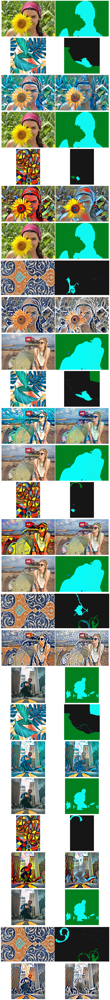

In [122]:
draw_pictures(pictures, cols=2, figsize=(6, 4))

# Method 3
* Superpixel segmentation: find watershed basins in image flooded from given markers

In [125]:
from skimage.color import rgb2gray
from skimage.filters import sobel

def superpixel_segment_ws(style_image, params={"markers":10, "compactness":0.001}):
    gradient = sobel(rgb2gray(np.array(style_image)))
    segments_slic = watershed(gradient, **params)
    prep_superpix = transforms.Compose([
                           transforms.ToTensor(),
                           transforms.Resize(img_size)
                          ])
    style_seg = prep_superpix(segments_slic).unsqueeze(0).to(DEVICE)
    # print(style_seg.shape, style_seg.dtype)
    # print(style_image.shape)

    return style_seg

In [126]:
imgs, style_image, content_image = load_images("1.jpg", "1.jpg")
content_seg = deeplab_segment(imgs[1])
style_seg = superpixel_segment_ws(imgs[0])

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=DeepLabV3_ResNet101_Weights.COCO_WITH_VOC_LABELS_V1`. You can also use `weights=DeepLabV3_ResNet101_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


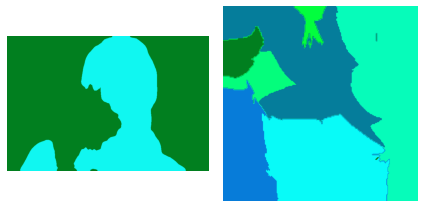

In [127]:
pictures = [segmap_p(content_seg), segmap_p(style_seg)]
draw_pictures(pictures, cols=3)

In [130]:
pictures = []
for content in ["1.jpg", "2.jpg", "3.jpg"]:
    content_row = []
    for style in ["1.jpg", "2.jpg", "3.jpg"]:
        imgs, style_image, content_image = load_images(style, content)
        content_seg = deeplab_segment(imgs[1])
        style_seg = superpixel_segment_ws(imgs[0], params={"markers":10, "compactness":0.001})
        out, superpixel_visual = style_transfer(style_image, content_image, content_seg, style_seg, max_iter=500)
        original_out = original_style_transfer(style_image, content_image, max_iter=500)
        pictures += [imgs[1], segmap_p(content_seg.cpu()), imgs[0], segmap_p(superpixel_visual.cpu()), original_out, out]

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=DeepLabV3_ResNet101_Weights.COCO_WITH_VOC_LABELS_V1`. You can also use `weights=DeepLabV3_ResNet101_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Iteration: 50, loss: 113837568.000000
Iteration: 100, loss: 53647048.000000
Iteration: 150, loss: 31439066.000000
Iteration: 200, loss: 21351980.000000
Iteration: 250, loss: 17310758.000000
Iteration: 300, loss: 15074013.000000
Iteration: 350, loss: 13490880.000000
Iteration: 400, loss: 12415888.000000
Iteration: 450, loss: 11600381.000000
Iteration: 500, loss: 10997615.000000
Iteration: 50, loss: 25108104.000000
Iteration: 100, loss: 14350220.000000
Iteration: 150, loss: 4947003.000000
Iteration: 200, loss: 2681987.000000
Iteration: 250, loss: 2013523.500000
Iteration: 300, loss: 1592005.625000
Iteration: 350, loss: 1383110.750000
Iteration: 400, loss: 1269069.250000
Iteration: 450, loss: 1167589.750000
Iteration: 500, loss: 1100565.250000


Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Iteration: 50, loss: 72451128.000000
Iteration: 100, loss: 33215928.000000
Iteration: 150, loss: 21076216.000000
Iteration: 200, loss: 15549420.000000
Iteration: 250, loss: 12471744.000000
Iteration: 300, loss: 10425802.000000
Iteration: 350, loss: 9059632.000000
Iteration: 400, loss: 8103085.000000
Iteration: 450, loss: 7380901.500000
Iteration: 500, loss: 6803099.000000
Iteration: 50, loss: 19261554.000000
Iteration: 100, loss: 7565871.000000
Iteration: 150, loss: 4339090.500000
Iteration: 200, loss: 3003491.250000
Iteration: 250, loss: 2319107.000000
Iteration: 300, loss: 1924045.500000
Iteration: 350, loss: 1670330.250000
Iteration: 400, loss: 1499446.500000
Iteration: 450, loss: 1375095.000000
Iteration: 500, loss: 1282929.625000


Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Iteration: 50, loss: 38653212.000000
Iteration: 100, loss: 14362960.000000
Iteration: 150, loss: 9020875.000000
Iteration: 200, loss: 7005356.000000
Iteration: 250, loss: 6003147.500000
Iteration: 300, loss: 5370670.000000
Iteration: 350, loss: 4946897.500000
Iteration: 400, loss: 4646812.000000
Iteration: 450, loss: 4431986.000000
Iteration: 500, loss: 4261089.000000
Iteration: 50, loss: 7276232.500000
Iteration: 100, loss: 1899539.750000
Iteration: 150, loss: 1126704.000000
Iteration: 200, loss: 885996.250000
Iteration: 250, loss: 774045.312500
Iteration: 300, loss: 710800.937500
Iteration: 350, loss: 670606.125000
Iteration: 400, loss: 642533.187500
Iteration: 450, loss: 622560.875000
Iteration: 500, loss: 607285.500000


Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Iteration: 50, loss: 2964860928.000000
Iteration: 100, loss: 1901543808.000000
Iteration: 150, loss: 1563925376.000000
Iteration: 200, loss: 1389788544.000000
Iteration: 250, loss: 1298254720.000000
Iteration: 300, loss: 1245815424.000000
Iteration: 350, loss: 1212437376.000000
Iteration: 400, loss: 1188548352.000000
Iteration: 450, loss: 1169935232.000000
Iteration: 500, loss: 1154782080.000000
Iteration: 50, loss: 27809980.000000
Iteration: 100, loss: 10432657.000000
Iteration: 150, loss: 6120104.000000
Iteration: 200, loss: 2850422.000000
Iteration: 250, loss: 2129765.500000
Iteration: 300, loss: 1757549.000000
Iteration: 350, loss: 1468602.750000
Iteration: 400, loss: 1304776.500000
Iteration: 450, loss: 1199130.500000
Iteration: 500, loss: 1106349.000000


Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Iteration: 50, loss: 1498455168.000000
Iteration: 100, loss: 864968192.000000
Iteration: 150, loss: 633114752.000000
Iteration: 200, loss: 516168640.000000
Iteration: 250, loss: 443778048.000000
Iteration: 300, loss: 393640128.000000
Iteration: 350, loss: 358283136.000000
Iteration: 400, loss: 332027040.000000
Iteration: 450, loss: 311413376.000000
Iteration: 500, loss: 294348192.000000
Iteration: 50, loss: 26965802.000000
Iteration: 100, loss: 10117643.000000
Iteration: 150, loss: 5644130.000000
Iteration: 200, loss: 3783601.500000
Iteration: 250, loss: 2823867.000000
Iteration: 300, loss: 2260338.000000
Iteration: 350, loss: 1911467.375000
Iteration: 400, loss: 1658944.125000
Iteration: 450, loss: 1489142.375000
Iteration: 500, loss: 1366547.250000


Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Iteration: 50, loss: 987159744.000000
Iteration: 100, loss: 607000832.000000
Iteration: 150, loss: 476898112.000000
Iteration: 200, loss: 420794784.000000
Iteration: 250, loss: 393190208.000000
Iteration: 300, loss: 374391008.000000
Iteration: 350, loss: 359604640.000000
Iteration: 400, loss: 348813184.000000
Iteration: 450, loss: 341199488.000000
Iteration: 500, loss: 335279808.000000
Iteration: 50, loss: 7244549.000000
Iteration: 100, loss: 2266002.000000
Iteration: 150, loss: 1350939.250000
Iteration: 200, loss: 1013637.625000
Iteration: 250, loss: 844093.750000
Iteration: 300, loss: 748182.000000
Iteration: 350, loss: 687483.687500
Iteration: 400, loss: 647672.750000
Iteration: 450, loss: 619260.000000
Iteration: 500, loss: 598426.000000


Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Iteration: 50, loss: 140751536.000000
Iteration: 100, loss: 69583008.000000
Iteration: 150, loss: 46665444.000000
Iteration: 200, loss: 35464064.000000
Iteration: 250, loss: 28047700.000000
Iteration: 300, loss: 23472596.000000
Iteration: 350, loss: 20485084.000000
Iteration: 400, loss: 18360238.000000
Iteration: 450, loss: 16748273.000000
Iteration: 500, loss: 15371497.000000
Iteration: 50, loss: 21271134.000000
Iteration: 100, loss: 8694180.000000
Iteration: 150, loss: 3985001.500000
Iteration: 200, loss: 2721321.750000
Iteration: 250, loss: 2179799.250000
Iteration: 300, loss: 1803265.125000
Iteration: 350, loss: 1597519.375000
Iteration: 400, loss: 1472913.250000
Iteration: 450, loss: 1335556.500000
Iteration: 500, loss: 1236009.125000


Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Iteration: 50, loss: 156650736.000000
Iteration: 100, loss: 76109000.000000
Iteration: 150, loss: 49746936.000000
Iteration: 200, loss: 36637452.000000
Iteration: 250, loss: 29172902.000000
Iteration: 300, loss: 24291970.000000
Iteration: 350, loss: 20994622.000000
Iteration: 400, loss: 18588126.000000
Iteration: 450, loss: 16834146.000000
Iteration: 500, loss: 15475107.000000
Iteration: 50, loss: 28535344.000000
Iteration: 100, loss: 11047577.000000
Iteration: 150, loss: 6356543.500000
Iteration: 200, loss: 4381367.000000
Iteration: 250, loss: 3383663.750000
Iteration: 300, loss: 2790490.500000
Iteration: 350, loss: 2424252.500000
Iteration: 400, loss: 2161525.000000
Iteration: 450, loss: 1975258.250000
Iteration: 500, loss: 1828800.250000


Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Iteration: 50, loss: 46331800.000000
Iteration: 100, loss: 23771540.000000
Iteration: 150, loss: 16273871.000000
Iteration: 200, loss: 12658540.000000
Iteration: 250, loss: 10552616.000000
Iteration: 300, loss: 9289436.000000
Iteration: 350, loss: 8432408.000000
Iteration: 400, loss: 7808605.000000
Iteration: 450, loss: 7351113.500000
Iteration: 500, loss: 6980747.500000
Iteration: 50, loss: 5664588.000000
Iteration: 100, loss: 2324603.000000
Iteration: 150, loss: 1552159.250000
Iteration: 200, loss: 1247412.875000
Iteration: 250, loss: 1082391.125000
Iteration: 300, loss: 978101.500000
Iteration: 350, loss: 910154.812500
Iteration: 400, loss: 862924.937500
Iteration: 450, loss: 828602.250000
Iteration: 500, loss: 801613.125000


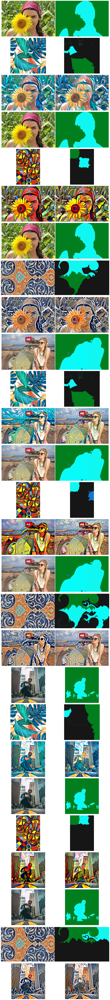

In [131]:
draw_pictures(pictures, cols=2, figsize=(6, 4))

# Style vs content tradeoff

In [ ]:
alphas = [1e-6, 1e-4, 1e-2, 1, 100, 10000]
outs = []
for s_alpha in alphas:
    out = style_transfer(style_image, content_image, content_seg, style_seg, s_alpha=s_alpha, max_iter=500)
    outs.append(out)

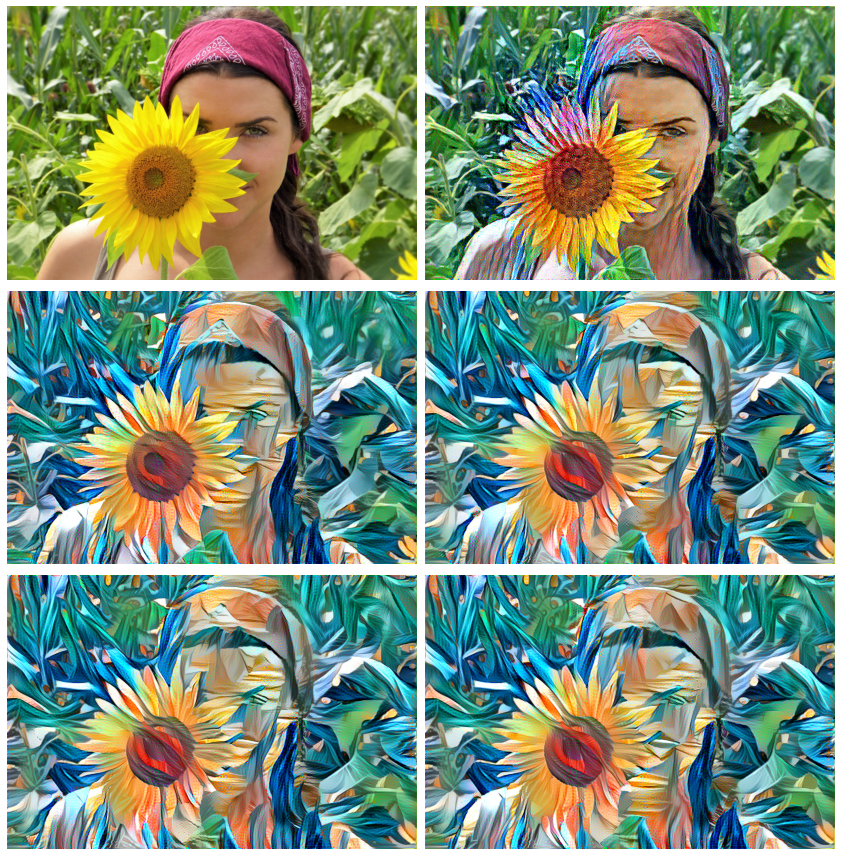

In [ ]:
draw_pictures(outs, cols=2, figsize=(12,12))